In the hepatic lobular dataset, we first integrate information from 10 Cosmx hepatic lobules to create landmark library and a spatial gene expression atlas of the lobules. We then introduce two Visium liver slices with different health states and use ARIEL to assist in lobule localization and analysis. By performing correlation analysis with the Cosmx atlas, we identify genes potentially associated with fatty liver disease.

In [1]:
%load_ext autoreload
%autoreload 2

import numpy as np
import math
import torch
import matplotlib.pyplot as plt
import scanpy as sc
import squidpy as sq
import anndata as ad
import pandas as pd
import anndata
from sklearn.cluster import KMeans
from scipy.spatial import ConvexHull, Delaunay
from ariel_srt.Landmark import normalization_spatial, Rasterization, alternative_landmark, screen_landmark
from ariel_srt.Alignment import rigid_alignment, non_rigid_alignment
from ariel_srt.Transfer import Appro_GP, Exact_GP

In [2]:
path = './data/hepatic lobular'

# COSMX 

In [3]:
for i in range(1,11):
    globals()[f"data_slice{i}"]=sc.read_h5ad(f'{path}/data_slice{i}.h5ad')

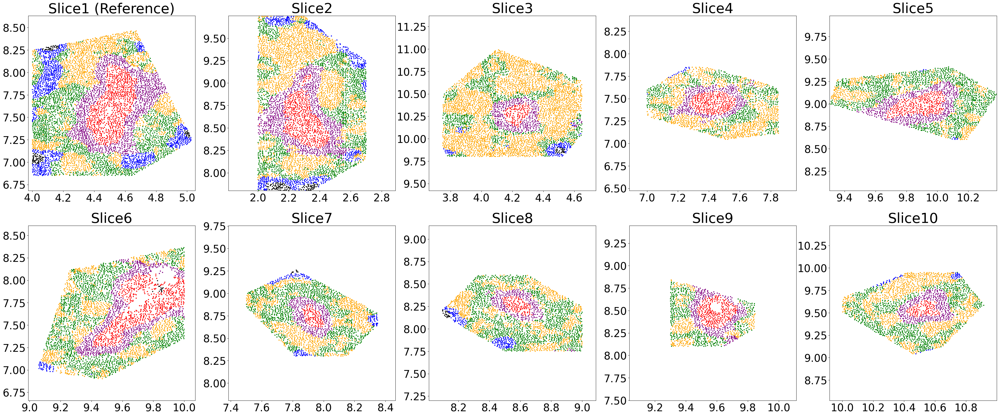

In [4]:
# Basic original information of ten Cosmx hepatic lobulars

cl={}
sp={}
for i in range(1, 11):
    cl[f"data_slice{i}"]=globals()[f"data_slice{i}"].obsm['color']
    sp[f"data_slice{i}"]=globals()[f"data_slice{i}"].obsm['spatial']
num_plot = len(cl)

dx = []
dy = []
for j in range(10):
    dx.append(sp[f"data_slice{j+1}"][:,0].max() - sp[f"data_slice{j+1}"][:,0].min())
    dy.append(sp[f"data_slice{j+1}"][:,1].max() - sp[f"data_slice{j+1}"][:,1].min())
dx = max(dx)
dy = max(dy)

plt.figure(figsize=((50,20)))
for j in range(num_plot):
    plt.subplot(2,5,j+1)
    sp0 = sp[f'data_slice{j+1}']
    cl0 = cl[f'data_slice{j+1}']

    plt.scatter(sp0[:,0],sp0[:,1],s=5,c=cl0)
    if(j==0):
        plt.title('Slice1 (Reference)',fontsize=40)
    else:
        plt.title(f'Slice{j+1}',fontsize=40)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

    dd = sp[f"data_slice{j+1}"][:,0].max() - sp[f"data_slice{j+1}"][:,0].min()
    plt.xlim(xmin=sp[f"data_slice{j+1}"][:,0].min() - (dx-dd)/2, xmax=sp[f"data_slice{j+1}"][:,0].max() + (dx-dd)/2)
    dd = sp[f"data_slice{j+1}"][:,1].max() - sp[f"data_slice{j+1}"][:,1].min()
    plt.ylim(ymin=sp[f"data_slice{j+1}"][:,1].min() - (dy-dd)/2, ymax=sp[f"data_slice{j+1}"][:,1].max() + (dy-dd)/2)


## Select landmarks

In [5]:
spatial1 = normalization_spatial(data_slice1.obsm['spatial'])
data_slice1.obsm['spatial'] = spatial1

In [6]:
for i in range(2,11):
    globals()[f'lm1_{i}'], globals()[f'lm{i}'] = alternative_landmark(spatial1, globals()[f"data_slice{i}"].obsm['spatial'], data_slice1.obsm['pca'], globals()[f"data_slice{i}"].obsm['pca'], n = 100)

### slice 2

In [8]:
lm1_2=lm1_2[[38,3,48,49,30,24],:]
lm2=lm2[[24,3,49,30,48,38],:]
D=[]
for i in range(6):
    lm2_test = np.vstack((lm2[range(i,6),:],lm2[range(0,i),:])) 
    lm2_test = rigid_alignment(lm1_2, lm2_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm2_test-lm1_2,2),axis=1)))
    D.append(d)
lm2 = np.vstack((lm2[range(np.argmin(D),6),:],lm2[range(0,np.argmin(D)),:])) 

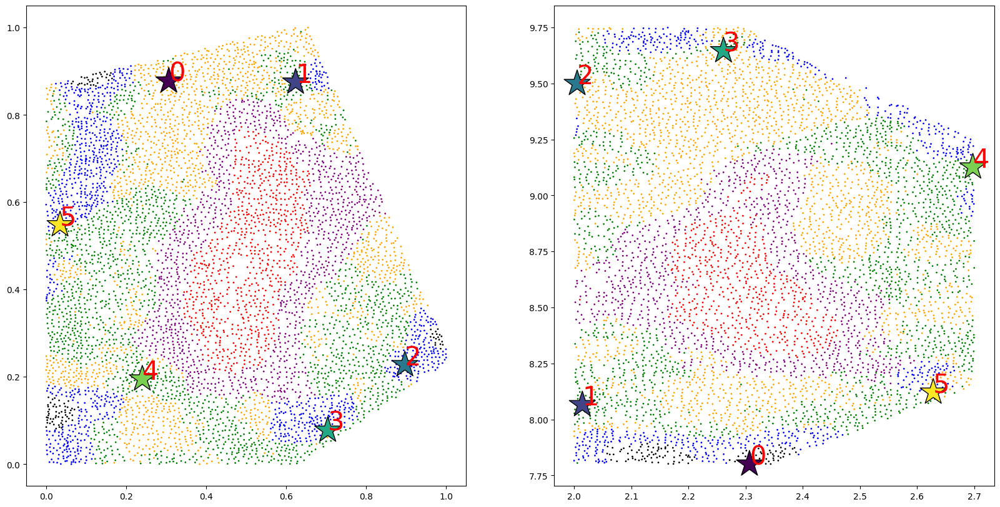

In [11]:
plt.figure(figsize=((20,10)))
plt.subplot(1,2,1)
plt.scatter(spatial1[:,0],spatial1[:,1],s=1,c=data_slice1.obsm['color'])
plt.scatter(lm1_2[:,0],lm1_2[:,1],s = 1000,c=range(lm1_2.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm1_2.shape[0]):
    plt.text(lm1_2[i,0],lm1_2[i,1],f'{i}', c='red',fontsize=30)

plt.subplot(1,2,2)
plt.scatter(data_slice2.obsm['spatial'][:,0],data_slice2.obsm['spatial'][:,1],s=1,c=data_slice2.obsm['color'])
plt.scatter(lm2[:,0],lm2[:,1],s = 1000,c=range(lm2.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm2.shape[0]):
    plt.text(lm2[i,0],lm2[i,1],f'{i}', c='red',fontsize=30)

### slice3

In [12]:
lm1_3=lm1_3[[13,12,5,22,1,46],:]
lm3=lm3[[12,1,22,5,46,13],:]
D=[]
for i in range(6):
    lm3_test = np.vstack((lm3[range(i,6),:],lm3[range(0,i),:])) 
    lm3_test = rigid_alignment(lm1_3, lm3_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm3_test-lm1_3,2),axis=1)))
    D.append(d)
lm3=np.vstack((lm3[range(np.argmin(D),6),:],lm3[range(0,np.argmin(D)),:])) 

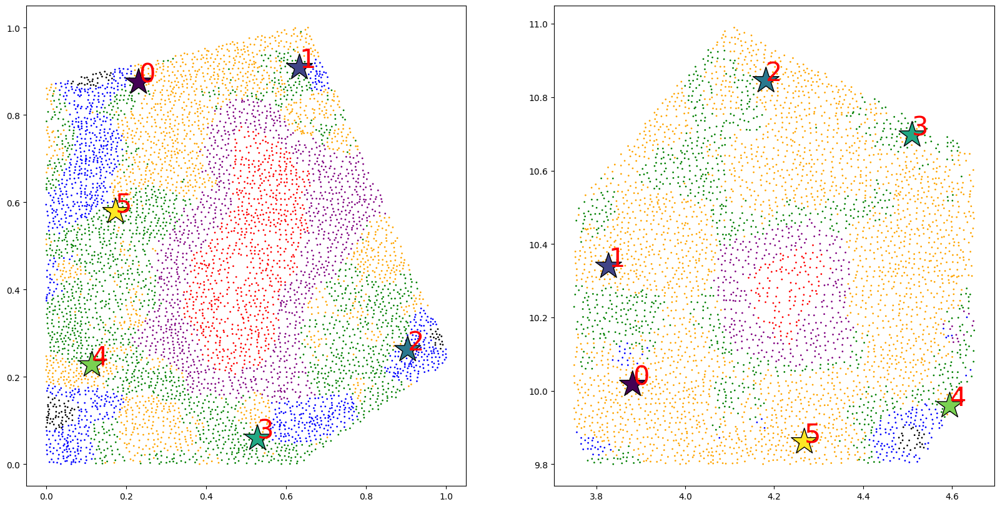

In [13]:
plt.figure(figsize=((20,10)))
plt.subplot(1,2,1)
plt.scatter(spatial1[:,0],spatial1[:,1],s=1,c=data_slice1.obsm['color'])
plt.scatter(lm1_3[:,0],lm1_3[:,1],s = 1000,c=range(lm1_3.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm1_3.shape[0]):
    plt.text(lm1_3[i,0],lm1_3[i,1],f'{i}', c='red',fontsize=30)

plt.subplot(1,2,2)
plt.scatter(data_slice3.obsm['spatial'][:,0],data_slice3.obsm['spatial'][:,1],s=1,c=data_slice3.obsm['color'])
plt.scatter(lm3[:,0],lm3[:,1],s = 1000,c=range(lm3.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm3.shape[0]):
    plt.text(lm3[i,0],lm3[i,1],f'{i}', c='red',fontsize=30)

### slice4

In [14]:
lm1_4=lm1_4[[27,43,44,28,89,48],:]
lm4=lm4[[28,48,89,59,27,43],:]

D=[]
for i in range(6):
    lm4_test = np.vstack((lm4[range(i,6),:],lm4[range(0,i),:])) 
    lm4_test = rigid_alignment(lm1_4, lm4_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm4_test-lm1_4,2),axis=1)))
    D.append(d)
lm4=np.vstack((lm4[range(np.argmin(D),6),:],lm4[range(0,np.argmin(D)),:])) 

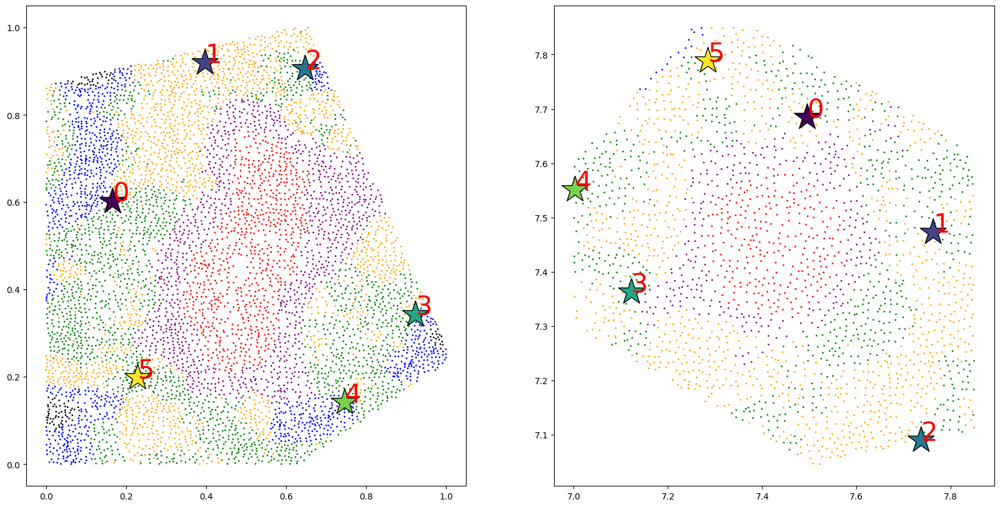

In [15]:
plt.figure(figsize=((20,10)))
plt.subplot(1,2,1)
plt.scatter(spatial1[:,0],spatial1[:,1],s=1,c=data_slice1.obsm['color'])
plt.scatter(lm1_4[:,0],lm1_4[:,1],s = 1000,c=range(lm1_4.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm1_4.shape[0]):
    plt.text(lm1_4[i,0],lm1_4[i,1],f'{i}', c='red',fontsize=30)

plt.subplot(1,2,2)
plt.scatter(data_slice4.obsm['spatial'][:,0],data_slice4.obsm['spatial'][:,1],s=1,c=data_slice4.obsm['color'])
plt.scatter(lm4[:,0],lm4[:,1],s = 1000,c=range(lm4.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm4.shape[0]):
    plt.text(lm4[i,0],lm4[i,1],f'{i}', c='red',fontsize=30)

### slice5

In [16]:
lm1_5=lm1_5[[33,16,26,45,30,52],:]
lm5=lm5[[33,52,30,16,45,26],:]

D=[]
for i in range(6):
    lm5_test = np.vstack((lm5[range(i,6),:],lm5[range(0,i),:])) 
    lm5_test = rigid_alignment(lm1_5, lm5_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm5_test-lm1_5,2),axis=1)))
    D.append(d)
lm5=np.vstack((lm5[range(np.argmin(D),6),:],lm5[range(0,np.argmin(D)),:])) 

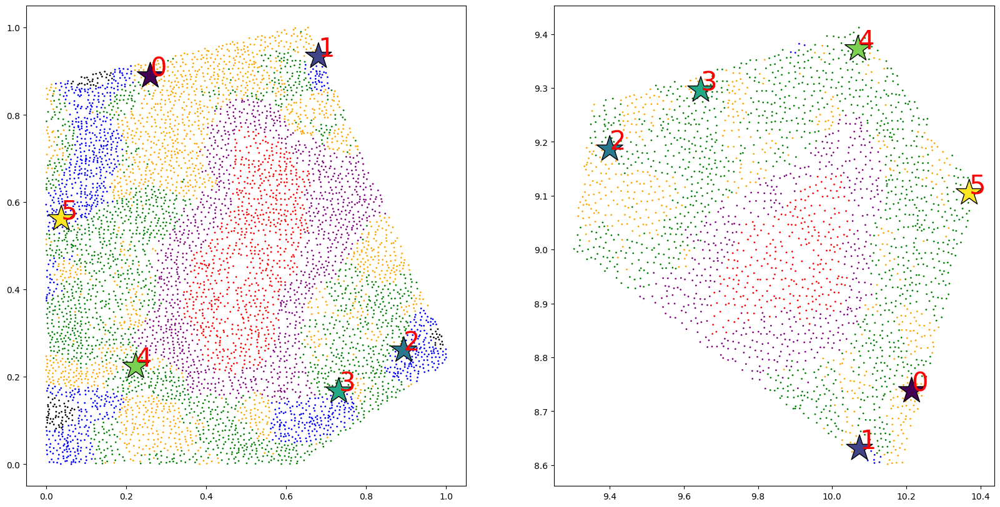

In [17]:
plt.figure(figsize=((20,10)))
plt.subplot(1,2,1)
plt.scatter(spatial1[:,0],spatial1[:,1],s=1,c=data_slice1.obsm['color'])
plt.scatter(lm1_5[:,0],lm1_5[:,1],s = 1000,c=range(lm1_5.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm1_5.shape[0]):
    plt.text(lm1_5[i,0],lm1_5[i,1],f'{i}', c='red',fontsize=30)

plt.subplot(1,2,2)
plt.scatter(data_slice5.obsm['spatial'][:,0],data_slice5.obsm['spatial'][:,1],s=1,c=data_slice5.obsm['color'])
plt.scatter(lm5[:,0],lm5[:,1],s = 1000,c=range(lm5.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm5.shape[0]):
    plt.text(lm5[i,0],lm5[i,1],f'{i}', c='red',fontsize=30)

### slice6

In [18]:
lm1_6=lm1_6[[53,5,23,60,9,65],:]
lm6=lm6[[5,60,53,65,9,23],:]

D=[]
for i in range(6):
    lm6_test = np.vstack((lm6[range(i,6),:],lm6[range(0,i),:])) 
    lm6_test = rigid_alignment(lm1_6, lm6_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm6_test-lm1_6,2),axis=1)))
    D.append(d)
lm6 = np.vstack((lm6[range(np.argmin(D),6),:],lm6[range(0,np.argmin(D)),:])).copy() 

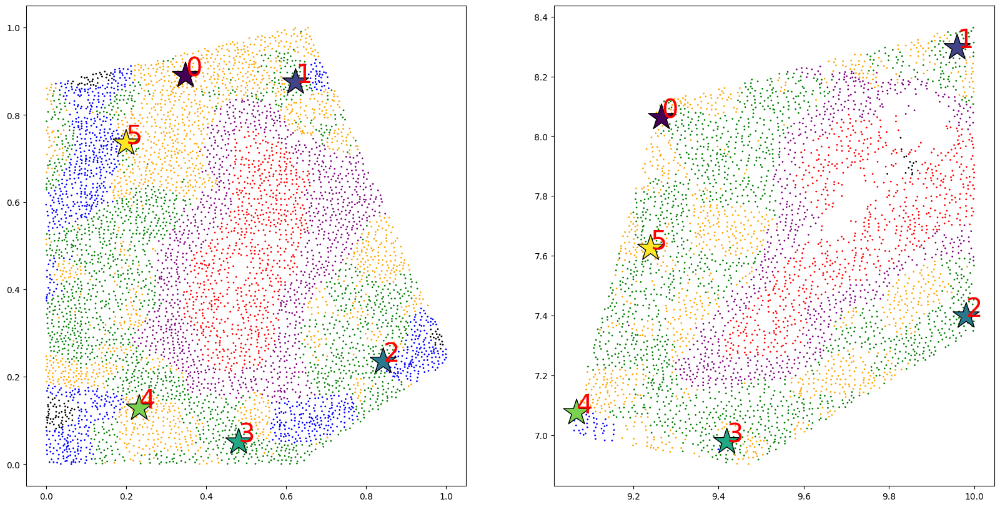

In [19]:
plt.figure(figsize=((20,10)))
plt.subplot(1,2,1)
plt.scatter(spatial1[:,0],spatial1[:,1],s=1,c=data_slice1.obsm['color'])
plt.scatter(lm1_6[:,0],lm1_6[:,1],s = 1000,c=range(lm1_6.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm1_6.shape[0]):
    plt.text(lm1_6[i,0],lm1_6[i,1],f'{i}', c='red',fontsize=30)

plt.subplot(1,2,2)
plt.scatter(data_slice6.obsm['spatial'][:,0],data_slice6.obsm['spatial'][:,1],s=1,c=data_slice6.obsm['color'])
plt.scatter(lm6[:,0],lm6[:,1],s = 1000,c=range(lm6.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm6.shape[0]):
    plt.text(lm6[i,0],lm6[i,1],f'{i}', c='red',fontsize=30)

### slice7

In [20]:
lm1_7=lm1_7[[5,37,18,10,7,0],:]
lm7=lm7[[10,18,5,0,37,7],:]

D=[]
for i in range(6):
    lm7_test = np.vstack((lm7[range(i,6),:],lm7[range(0,i),:])) 
    lm7_test = rigid_alignment(lm1_7, lm7_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm7_test-lm1_7,2),axis=1)))
    D.append(d)
lm7=np.vstack((lm7[range(np.argmin(D),6),:],lm7[range(0,np.argmin(D)),:])) 

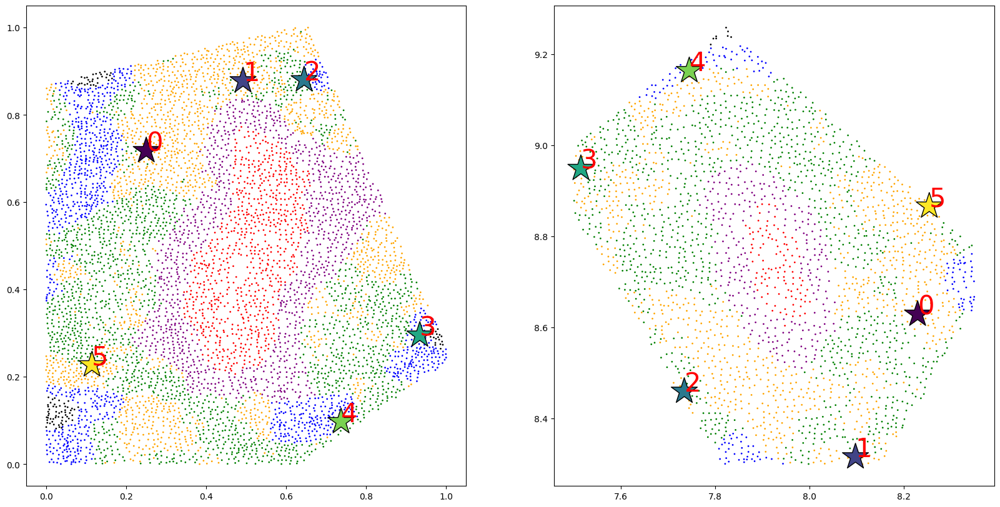

In [21]:
plt.figure(figsize=((20,10)))
plt.subplot(1,2,1)
plt.scatter(spatial1[:,0],spatial1[:,1],s=1,c=data_slice1.obsm['color'])
plt.scatter(lm1_7[:,0],lm1_7[:,1],s = 1000,c=range(lm1_7.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm1_7.shape[0]):
    plt.text(lm1_7[i,0],lm1_7[i,1],f'{i}', c='red',fontsize=30)

plt.subplot(1,2,2)
plt.scatter(data_slice7.obsm['spatial'][:,0],data_slice7.obsm['spatial'][:,1],s=1,c=data_slice7.obsm['color'])
plt.scatter(lm7[:,0],lm7[:,1],s = 1000,c=range(lm7.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm7.shape[0]):
    plt.text(lm7[i,0],lm7[i,1],f'{i}', c='red',fontsize=30)

### slice8

In [22]:
lm1_8=lm1_8[[23,0,45,25,6,15],:]
lm8=lm8[[25,6,15,23,45,0],:]

D=[]
for i in range(6):
    lm8_test = np.vstack((lm8[range(i,6),:],lm8[range(0,i),:])) 
    lm8_test = rigid_alignment(lm1_8, lm8_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm8_test-lm1_8,2),axis=1)))
    D.append(d)
lm8=np.vstack((lm8[range(np.argmin(D),6),:],lm8[range(0,np.argmin(D)),:])) 

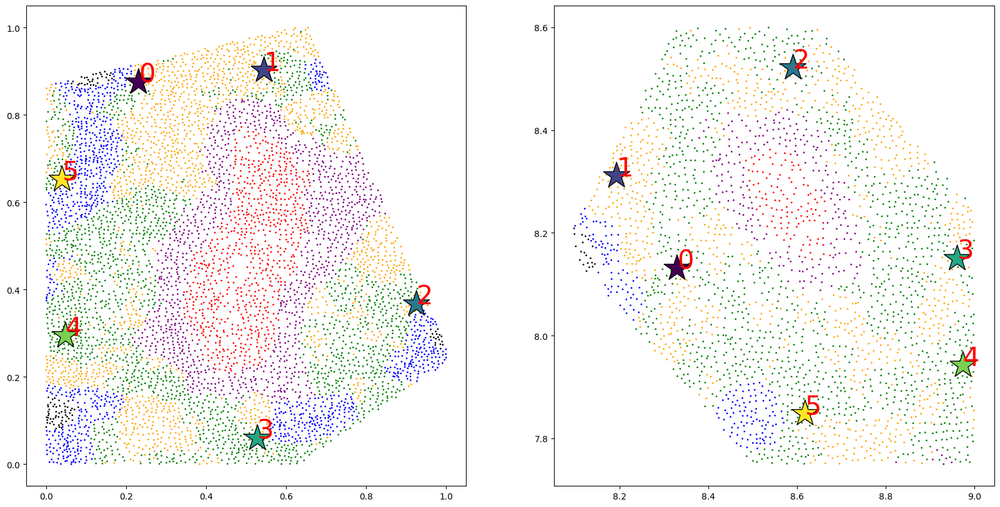

In [23]:
plt.figure(figsize=((20,10)))
plt.subplot(1,2,1)
plt.scatter(spatial1[:,0],spatial1[:,1],s=1,c=data_slice1.obsm['color'])
plt.scatter(lm1_8[:,0],lm1_8[:,1],s = 1000,c=range(lm1_8.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm1_8.shape[0]):
    plt.text(lm1_8[i,0],lm1_8[i,1],f'{i}', c='red',fontsize=30)

plt.subplot(1,2,2)
plt.scatter(data_slice8.obsm['spatial'][:,0],data_slice8.obsm['spatial'][:,1],s=1,c=data_slice8.obsm['color'])
plt.scatter(lm8[:,0],lm8[:,1],s = 1000,c=range(lm8.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm8.shape[0]):
    plt.text(lm8[i,0],lm8[i,1],f'{i}', c='red',fontsize=30)

### slice9

In [24]:
lm1_9=lm1_9[[29,9,45,58,32,12],:]
lm9=lm9[[9,29,58,45,12,32],:]

D=[]
for i in range(6):
    lm9_test = np.vstack((lm9[range(i,6),:],lm9[range(0,i),:])) 
    lm9_test = rigid_alignment(lm1_9, lm9_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm9_test-lm1_9,2),axis=1)))
    D.append(d)
lm9=np.vstack((lm9[range(np.argmin(D),6),:],lm9[range(0,np.argmin(D)),:])) 

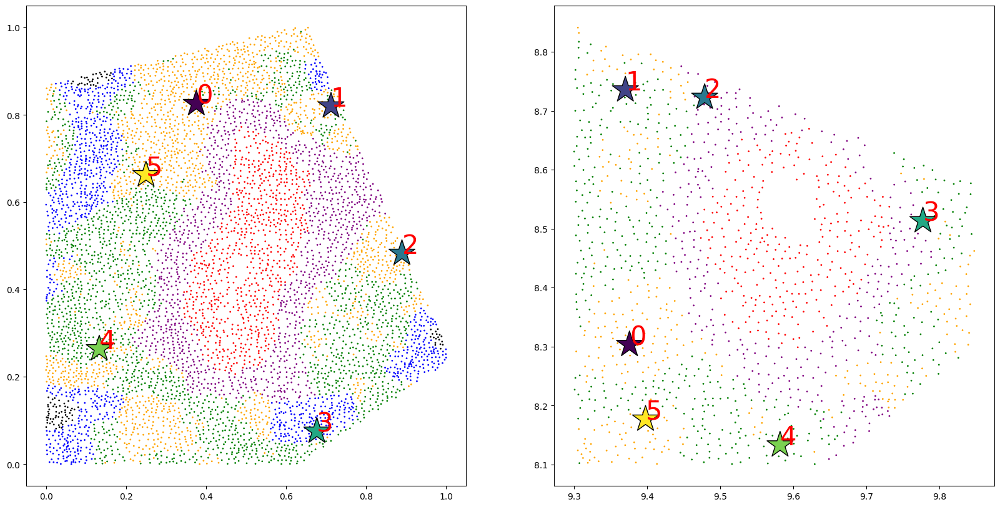

In [25]:
plt.figure(figsize=((20,10)))
plt.subplot(1,2,1)
plt.scatter(spatial1[:,0],spatial1[:,1],s=1,c=data_slice1.obsm['color'])
plt.scatter(lm1_9[:,0],lm1_9[:,1],s = 1000,c=range(lm1_9.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm1_9.shape[0]):
    plt.text(lm1_9[i,0],lm1_9[i,1],f'{i}', c='red',fontsize=30)

plt.subplot(1,2,2)
plt.scatter(data_slice9.obsm['spatial'][:,0],data_slice9.obsm['spatial'][:,1],s=1,c=data_slice9.obsm['color'])
plt.scatter(lm9[:,0],lm9[:,1],s = 1000,c=range(lm9.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm9.shape[0]):
    plt.text(lm9[i,0],lm9[i,1],f'{i}', c='red',fontsize=30)

### slice10

In [26]:
lm1_10=lm1_10[[19,44,0,15,47,26],:]
lm10=lm10[[44,15,0,47,19,26],:]

D=[]
for i in range(6):
    lm10_test = np.vstack((lm10[range(i,6),:],lm10[range(0,i),:])) 
    lm10_test = rigid_alignment(lm1_10, lm10_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm10_test-lm1_10,2),axis=1)))
    D.append(d)
lm10=np.vstack((lm10[range(np.argmin(D),6),:],lm10[range(0,np.argmin(D)),:])) 

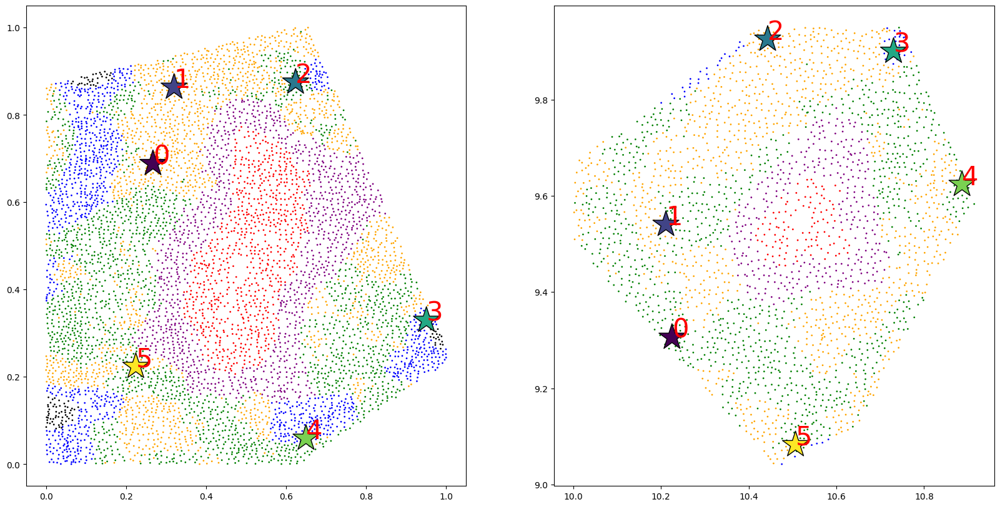

In [27]:
plt.figure(figsize=((20,10)))
plt.subplot(1,2,1)
plt.scatter(spatial1[:,0],spatial1[:,1],s=1,c=data_slice1.obsm['color'])
plt.scatter(lm1_10[:,0],lm1_10[:,1],s = 1000,c=range(lm1_10.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm1_10.shape[0]):
    plt.text(lm1_10[i,0],lm1_10[i,1],f'{i}', c='red',fontsize=30)

plt.subplot(1,2,2)
plt.scatter(data_slice10.obsm['spatial'][:,0],data_slice10.obsm['spatial'][:,1],s=1,c=data_slice10.obsm['color'])
plt.scatter(lm10[:,0],lm10[:,1],s = 1000,c=range(lm10.shape[0]),marker = "*",edgecolor = "black")
for i in range(lm10.shape[0]):
    plt.text(lm10[i,0],lm10[i,1],f'{i}', c='red',fontsize=30)

### Landmark results

In [28]:
dx = []
dy = []
for j in range(10):
    dx.append(globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].max() - globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].min())
    dy.append(globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].max() - globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].min())
dx = max(dx)
dy = max(dy)

C:\Users\10848\AppData\Local\Temp\ipykernel_25412\1291674392.py:11: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(globals()[f"lm1_{i}"][:,0],globals()[f"lm1_{i}"][:,1],s=500,c=plt.cm.tab10(i-1))
C:\Users\10848\AppData\Local\Temp\ipykernel_25412\1291674392.py:14: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(globals()[f"lm{j+1}"][:,0],globals()[f"lm{j+1}"][:,1],s=500,c=plt.cm.tab10(j))


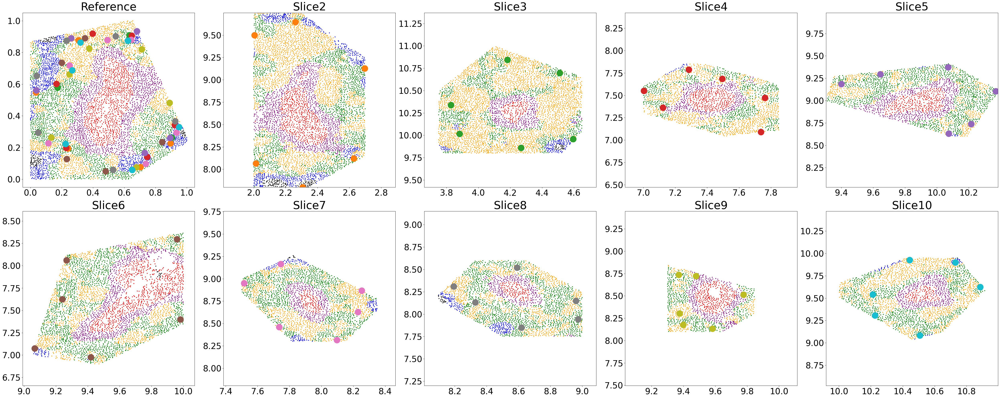

In [29]:
plt.figure(figsize=((50,20)))
for j in range(10):
    plt.subplot(2,5,j+1)

    plt.scatter(globals()[f'data_slice{j+1}'].obsm['spatial'][:,0],globals()[f'data_slice{j+1}'].obsm['spatial'][:,1],s=5,c=globals()[f'data_slice{j+1}'].obsm['color'])
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)
    if(j==0):
        plt.title('Reference',fontsize=40)
        for i in range(2,11):
            plt.scatter(globals()[f"lm1_{i}"][:,0],globals()[f"lm1_{i}"][:,1],s=500,c=plt.cm.tab10(i-1))
    else:
        plt.title(f'Slice{j+1}',fontsize=40)
        plt.scatter(globals()[f"lm{j+1}"][:,0],globals()[f"lm{j+1}"][:,1],s=500,c=plt.cm.tab10(j))
    
        dd = globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].max() - globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].min()
        plt.xlim(xmin=globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].min() - (dx-dd)/2, xmax=globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].max() + (dx-dd)/2)
        dd = globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].max() - globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].min()
        plt.ylim(ymin=globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].min() - (dy-dd)/2, ymax=globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].max() + (dy-dd)/2)
     

### Landmark library

We collected the expression information from all landmarks and their surrounding points on the reference, and output the result as a landmark library.

In [30]:
lm1 = np.empty((0,2))
for i in range(2,11):
    lm1 = np.vstack((lm1, globals()[f'lm1_{i}']))

In [31]:
spatial_new1, gene1=Rasterization(spatial1, data_slice1.X,nx=50,ny=50)
index_lmlibrary=[]
for i in range(lm1.shape[0]):
    k=np.argmin(np.power((spatial_new1[:,0]-lm1[i,0]),2)+np.power((spatial_new1[:,1]-lm1[i,1]),2))
    if not k in index_lmlibrary:
        index_lmlibrary.append(k)

In [32]:
lm_library = anndata.AnnData(X=gene1)
lm_library.obsm['spatial'] = spatial_new1
lm_library.var_names=data_slice1.var_names
lm_library.uns['index_lm'] = index_lmlibrary
print(lm_library)

AnnData object with n_obs × n_vars = 1992 × 1000
    uns: 'index_lm'
    obsm: 'spatial'


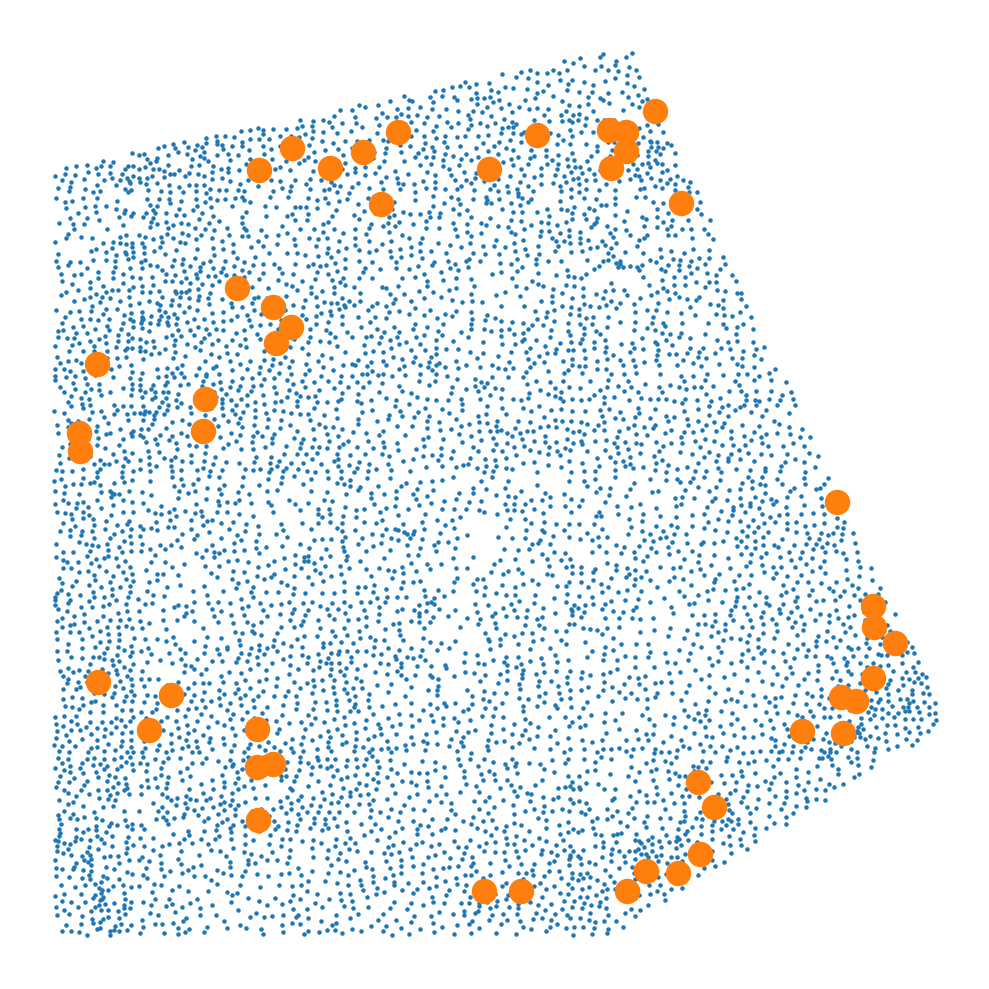

In [33]:
plt.figure(figsize=((10,10)))

plt.scatter(spatial1[:,0],spatial1[:,1],s=5)
plt.scatter(lm_library.obsm['spatial'][lm_library.uns['index_lm'],0],lm_library.obsm['spatial'][lm_library.uns['index_lm'],1],s=300)
plt.axis("off")

In [34]:
lm_library.write_h5ad(f'{path}/lm_library.h5ad')
gene = pd.DataFrame(lm_library.X)
gene.columns=data_slice1.var_names
gene.to_csv(f'{path}/lm_library_gene.csv', index=False)
pd.DataFrame(lm_library.obsm['spatial']).to_csv(f'{path}/lm_library_spatial.csv',header=False, index=False)

### Redefine the hepatic lobular

In [35]:
# The proportion of hepatocytes in the original hepatic lobule.
counts=pd.DataFrame(data=None,columns=['1','2','3','4','5','6','7','8','9','10','Average'])

for i in (np.unique(data_slice1.obsm['celltype'])):
    a=[]
    for j in range(1,11):
        a.append((globals()[f"data_slice{j}"].obsm['celltype']==i).sum())
    a.append(np.sum(a))
    counts.loc[i]=a

counts.loc['Hep']=counts.loc['Hep.1']+counts.loc['Hep.3']+counts.loc['Hep.4']+counts.loc['Hep.5']+counts.loc['Hep.6']
counts.drop(['Hep.1','Hep.3','Hep.4','Hep.5','Hep.6'],inplace=True)

print(counts.loc['Hep',:]/np.sum(counts,axis=0))

1          0.776621
2          0.779047
3          0.795340
4          0.859825
5          0.837450
6          0.802073
7          0.853897
8          0.833088
9          0.848306
10         0.825340
Average    0.808944
dtype: float64


In [36]:
lm = lm_library.obsm['spatial'][lm_library.uns['index_lm'],:]
hull=ConvexHull(lm)
delaunay = Delaunay(lm[hull.vertices])
result = delaunay.find_simplex(spatial1)>=0
data_slice1 = data_slice1[result,:]
spatial1 = spatial1[result,:]

for i in range(2,11):
    hull=ConvexHull(globals()[f"lm{i}"])
    delaunay = Delaunay(globals()[f"lm{i}"][hull.vertices])
    result = delaunay.find_simplex(globals()[f'data_slice{i}'].obsm['spatial'])>=0
    globals()[f'data_slice{i}'] = globals()[f'data_slice{i}'][result,:]
    globals()[f'spatial{i}'] = globals()[f'data_slice{i}'].obsm['spatial']

In [37]:
# The proportion of hepatocytes after redefine.
counts=pd.DataFrame(data=None,columns=['1','2','3','4','5','6','7','8','9','10','Ave'])

for i in (np.unique(data_slice1.obsm['celltype'])):
    a=[]
    for j in range(1,11):
        a.append((globals()[f"data_slice{j}"].obsm['celltype']==i).sum())
    
    a.append(np.sum(a))
    counts.loc[i]=a

counts.loc['Hep']=counts.loc['Hep.1']+counts.loc['Hep.3']+counts.loc['Hep.4']+counts.loc['Hep.5']+counts.loc['Hep.6']
counts.drop(['Hep.1','Hep.3','Hep.4','Hep.5','Hep.6'],inplace=True)

print(counts.loc['Hep',:]/np.sum(counts,axis=0))

1      0.793096
2      0.807366
3      0.802120
4      0.852370
5      0.830058
6      0.802128
7      0.867623
8      0.861751
9      0.839888
10     0.816804
Ave    0.816570
dtype: float64


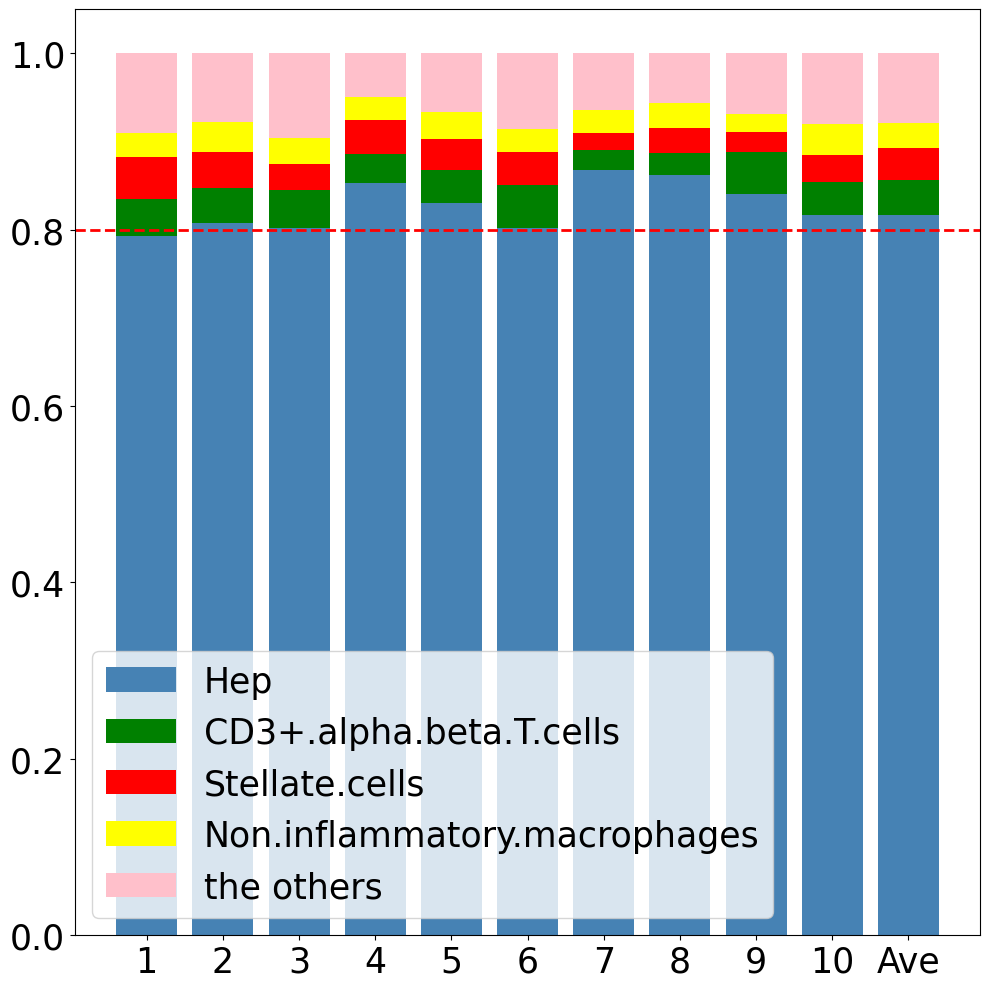

In [38]:
plt.figure(figsize=((10,10)))
slice = counts.columns
type1 = counts.iloc[ np.argsort(-counts['Ave'])[0],:]/np.sum(counts,axis=0)
type1.index = range(len(slice))
type2 = counts.iloc[ np.argsort(-counts['Ave'])[1],:]/np.sum(counts,axis=0)
type2.index = range(len(slice))
type3 = counts.iloc[ np.argsort(-counts['Ave'])[2],:]/np.sum(counts,axis=0)
type3.index = range(len(slice))
type4 = counts.iloc[ np.argsort(-counts['Ave'])[3],:]/np.sum(counts,axis=0)
type4.index = range(len(slice))
type5 = (counts.iloc[ np.argsort(-counts['Ave'])[range(4,len(counts['Ave']))].tolist() ,:]).sum(axis=0)/np.sum(counts,axis=0)
type5.index = range(len(slice))

plt.bar(x = range(len(slice)),
        height = type1, 
        bottom = 0,
        tick_label = slice,  
        color = 'steelblue',
        label = counts.index[np.argsort(-counts['Ave'])[0]],
        )

plt.bar(x = range(len(slice)),
        height = type2,
        bottom = type1,
        tick_label = slice,
        color = 'green', 
        label = counts.index[np.argsort(-counts['Ave'])[1]], 
        )

plt.bar(x = range(len(slice)), 
        height = type3,  
        bottom = type1+type2, 
        tick_label = slice, 
        color = 'red', 
        label = counts.index[np.argsort(-counts['Ave'])[2]],
        )

plt.bar(x = range(len(slice)),
        height = type4,
        bottom = type1+type2+type3,
        tick_label = slice, 
        color = 'yellow', 
        label = counts.index[np.argsort(-counts['Ave'])[3]],
        )

plt.bar(x = range(len(slice)),
        height = type5,
        bottom = type1+type2+type3+type4, 
        tick_label = slice, 
        color = 'pink', 
        label = 'the others', 
        )

plt.axhline(y=0.8, c='red', ls='--', lw=2)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)
plt.legend(prop = {'size':25})


C:\Users\10848\AppData\Local\Temp\ipykernel_25412\1640818477.py:10: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(globals()[f"lm1_{i}"][:,0],globals()[f"lm1_{i}"][:,1],s=500,c=plt.cm.tab10(i-1))
C:\Users\10848\AppData\Local\Temp\ipykernel_25412\1640818477.py:13: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(globals()[f"lm{j+1}"][:,0],globals()[f"lm{j+1}"][:,1],s=500,c=plt.cm.tab10(j))


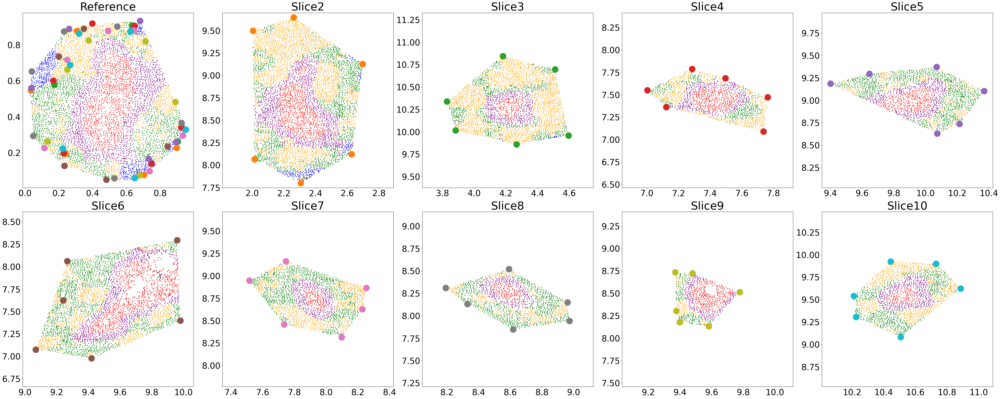

In [40]:
plt.figure(figsize=((50,20)))
for j in range(10):
    plt.subplot(2,5,j+1)
    plt.scatter(globals()[f"data_slice{j+1}"].obsm['spatial'][:,0],globals()[f"data_slice{j+1}"].obsm['spatial'][:,1],s=5,c=globals()[f"data_slice{j+1}"].obsm['color'])
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)
    if(j==0):
        plt.title('Reference',fontsize=40)
        for i in range(2,11):
            plt.scatter(globals()[f"lm1_{i}"][:,0],globals()[f"lm1_{i}"][:,1],s=500,c=plt.cm.tab10(i-1))
    else:
        plt.title(f'Slice{j+1}',fontsize=40)
        plt.scatter(globals()[f"lm{j+1}"][:,0],globals()[f"lm{j+1}"][:,1],s=500,c=plt.cm.tab10(j))
    
        dd = globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].max() - globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].min()
        plt.xlim(xmin=globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].min() - (dx-dd)/2, xmax=globals()[f"data_slice{j+1}"].obsm['spatial'][:,0].max() + (dx-dd)/2)
        dd = globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].max() - globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].min()
        plt.ylim(ymin=globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].min() - (dy-dd)/2, ymax=globals()[f"data_slice{j+1}"].obsm['spatial'][:,1].max() + (dy-dd)/2)


In [41]:
for i in range(1,11):
    globals()[f"data_slice{i}"].write_h5ad(f'{path}/data_slice{i}_redefine.h5ad')

## Alignment

### Rigid alignment

In [42]:
for i in range(2,11):
    globals()[f'lm{i}'], globals()[f'spatial{i}'] = rigid_alignment(globals()[f'lm1_{i}'], globals()[f'lm{i}'], globals()[f'spatial{i}'])

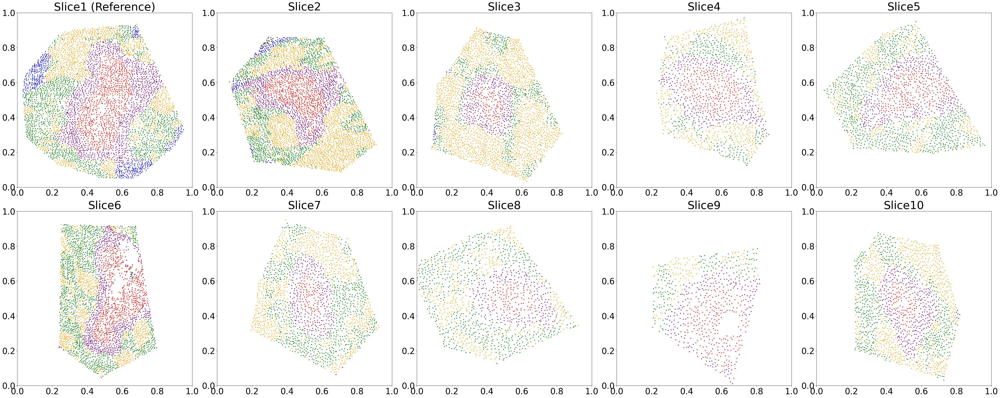

In [43]:
plt.figure(figsize=((50,20)))

for i in range(1,11):
    plt.subplot(2,5, i)
    
    plt.scatter(globals()[f"spatial{i}"][:,0],
                globals()[f"spatial{i}"][:,1],
                c=globals()[f'data_slice{i}'].obsm['color'],
                s=5)
    if(i==1):
        plt.title('Slice1 (Reference)',fontsize=40)
    else:
        plt.title(f'Slice{i}',fontsize=40)
        
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)
    plt.xlim(xmin=0, xmax=1)
    plt.ylim(ymin=0, ymax=1)
    

### Non-rigid alignment

In [44]:
import thinplate as tps
for i in range(2,11):
    globals()[f'lm1_{i}'] = lm1[range(6*(i-2),6*(i-1)),:]
    globals()[f'lm{i}'], globals()[f'spatial{i}'] = non_rigid_alignment(globals()[f'lm1_{i}'], globals()[f'lm{i}'], globals()[f'spatial{i}'])

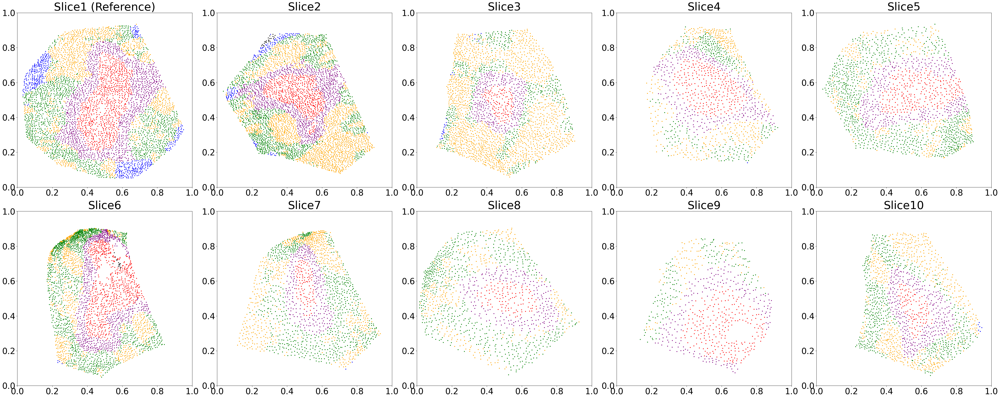

In [45]:
plt.figure(figsize=((50,20)))

for i in range(1,11):
    plt.subplot(2,5, i)
    
    plt.scatter(globals()[f"spatial{i}"][:,0],
                globals()[f"spatial{i}"][:,1],
                c=globals()[f'data_slice{i}'].obsm['color'],
                s=5)
    if(i==1):
        plt.title('Slice1 (Reference)',fontsize=40)
    else:
        plt.title(f'Slice{i}',fontsize=40)
    plt.xlim(xmin=0, xmax=1)
    plt.ylim(ymin=0, ymax=1)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

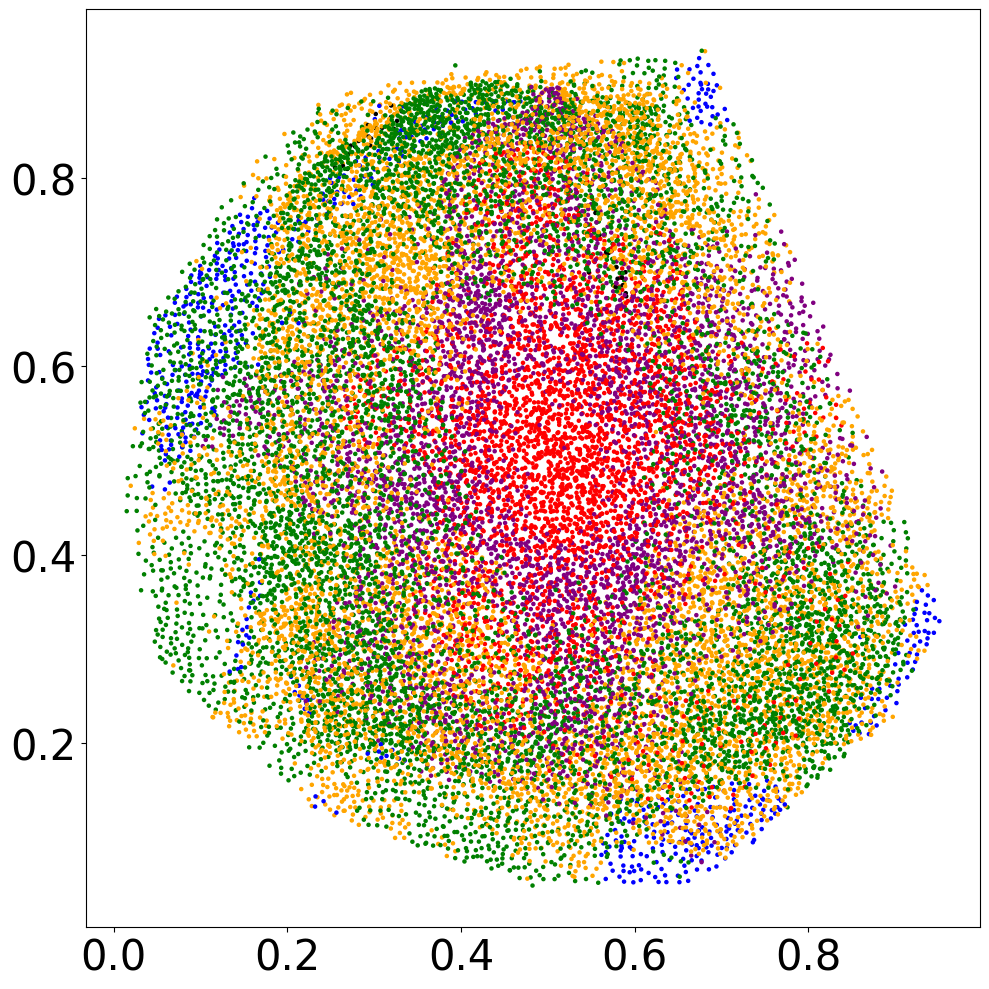

In [46]:
plt.figure(figsize=((10,10)))
for i in range(1,11):
    plt.scatter(globals()[f"spatial{i}"][:,0],
                globals()[f"spatial{i}"][:,1],
                c=globals()[f'data_slice{i}'].obsm['color'],
                s=5)

plt.xticks(fontsize=30)
plt.yticks(fontsize=30)

## Transfer

In [47]:
for i in range(1,11):
    x1 = torch.tensor(spatial1).float()
    x2 = torch.tensor(globals()[f'spatial{i}']).float()
    y2 = torch.tensor(globals()[f'data_slice{i}'].obsm['pca']).float()
    globals()[f'predictions{i}_pca'] = Appro_GP(x1, x2, y2, n_intro = 100, num_epochs = 500, lr = 0.01)
    globals()[f'predictions{i}_pca'] = globals()[f'predictions{i}_pca'].detach().numpy()
    globals()[f'y_predict{i}_pca_all'] = np.dot(globals()[f'predictions{i}_pca'],globals()[f'data_slice{i}'].varm['PCs'].T)
    pd.DataFrame(globals()[f'y_predict{i}_pca_all']).to_csv(f'{path}/data_slice{i}_pca_all_cut.csv',index=False)

E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\sklearn\cluster\_kmeans.py:1440: UserWarning: KMeans is known to have a memory leak on W

In [48]:
for i in range(1,11):
    globals()[f'y_predict{i}_pca_all']=np.array(pd.read_csv(f'{path}/data_slice{i}_pca_all_cut.csv',header=0))
    globals()[f'n_x{i}']=globals()[f'y_predict{i}_pca_all'].copy()
    for j in range(globals()[f'n_x{i}'].shape[1]):
        globals()[f'n_x{i}'][:,j]=globals()[f'n_x{i}'][:,j]-min(globals()[f'n_x{i}'][:,j])

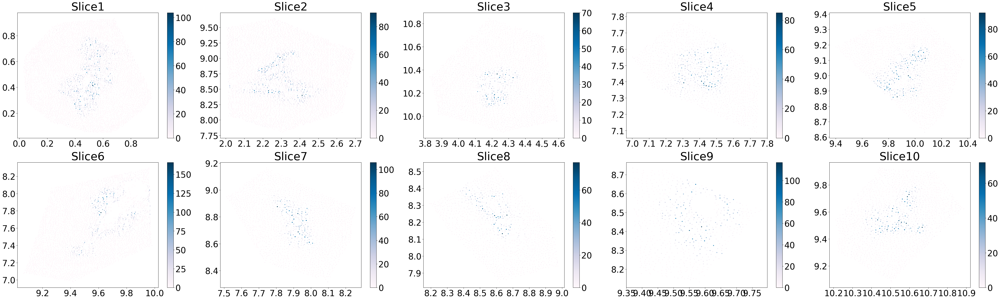

In [53]:
# Original spatial expression of GLUL
plt.figure(figsize=((50,15)))
for i in range(1,11):
    plt.subplot(2,5, i)
    
    plt.scatter(globals()[f'data_slice{i}'].obsm['spatial'][:,0],
                globals()[f'data_slice{i}'].obsm['spatial'][:,1],
                c=globals()[f'data_slice{i}'].X[:,np.where(data_slice1.var_names=='GLUL')[0][0]],
                cmap='PuBu',
                s=5)
    plt.colorbar().ax.tick_params(labelsize=30)
    plt.title(f'Slice{i}',fontsize=40)
        
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

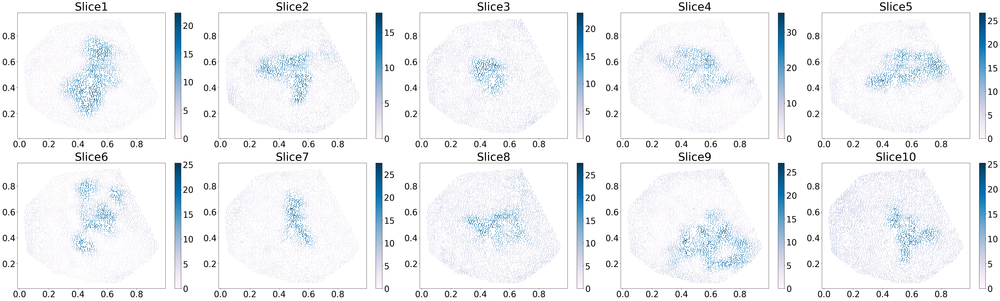

In [49]:
# spatial expression of GLUL after transfer
plt.figure(figsize=((50,15)))
for i in range(1,11):
    plt.subplot(2,5, i)
    
    plt.scatter(spatial1[:,0],
                spatial1[:,1],
                c=globals()[f'n_x{i}'][:,np.where(data_slice1.var_names=='GLUL')[0][0]],
                cmap='PuBu',
                s=5)
    plt.colorbar().ax.tick_params(labelsize=30)
    plt.title(f'Slice{i}',fontsize=40)
        
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

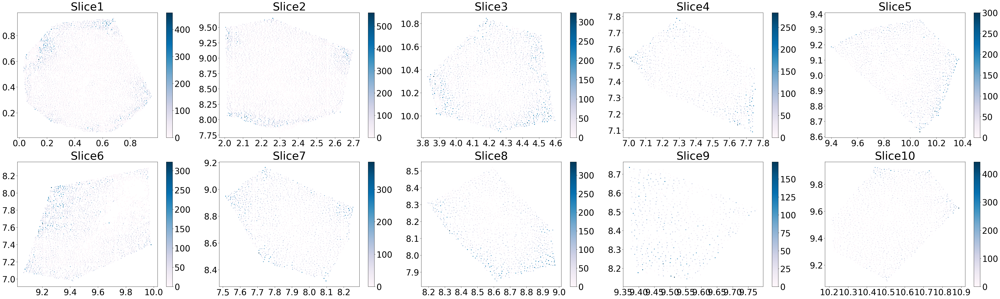

In [54]:
# Original spatial expression of SERPINA1
plt.figure(figsize=((50,15)))
for i in range(1,11):
    plt.subplot(2,5, i)
    
    plt.scatter(globals()[f'data_slice{i}'].obsm['spatial'][:,0],
                globals()[f'data_slice{i}'].obsm['spatial'][:,1],
                c=globals()[f'data_slice{i}'].X[:,np.where(data_slice1.var_names=='SERPINA1')[0][0]],
                cmap='PuBu',
                s=5)
    plt.colorbar().ax.tick_params(labelsize=30)
    plt.title(f'Slice{i}',fontsize=40)
        
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

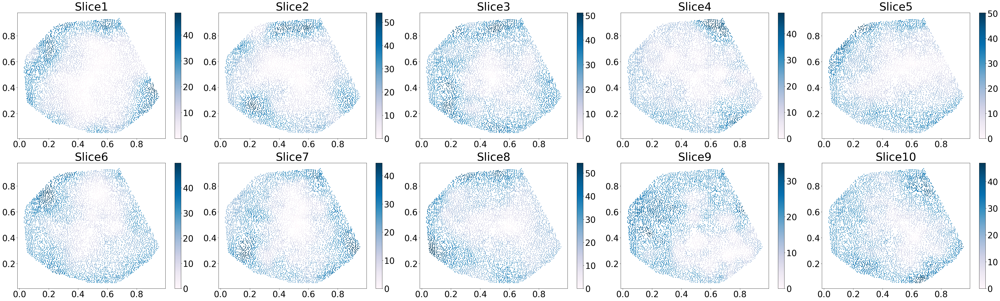

In [50]:
# spatial expression of SERPINA1 after transfer
plt.figure(figsize=((50,15)))
for i in range(1,11):
    plt.subplot(2,5, i)
    
    plt.scatter(spatial1[:,0],
                spatial1[:,1],
                c=globals()[f'n_x{i}'][:,np.where(data_slice1.var_names=='SERPINA1')[0][0]],
                cmap='PuBu',
                s=5)
    plt.colorbar().ax.tick_params(labelsize=30)
    plt.title(f'Slice{i}',fontsize=40)
        
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

## Spatial composite expression profiles

In [57]:
for i in range(1,11):
    globals()[f'n_x{i}_to01']=globals()[f'n_x{i}']
    for j in range(globals()[f'n_x{i}_to01'].shape[1]):
        globals()[f'n_x{i}_to01'][:,j]=(globals()[f'n_x{i}'][:,j]-np.min(globals()[f'n_x{i}'][:,j]))/(np.max(globals()[f'n_x{i}'][:,j])-np.min(globals()[f'n_x{i}'][:,j]))

composite=np.zeros(globals()[f'n_x{i}_to01'].shape)
for i in range(1,11):
    composite=composite+globals()[f'n_x{i}_to01']

composite=composite/10
composite=anndata.AnnData(X=composite)
composite.obsm['spatial']=data_slice1.obsm['spatial']
composite.var_names=data_slice1.var_names
composite.write_h5ad(f'{path}/composite.h5ad')

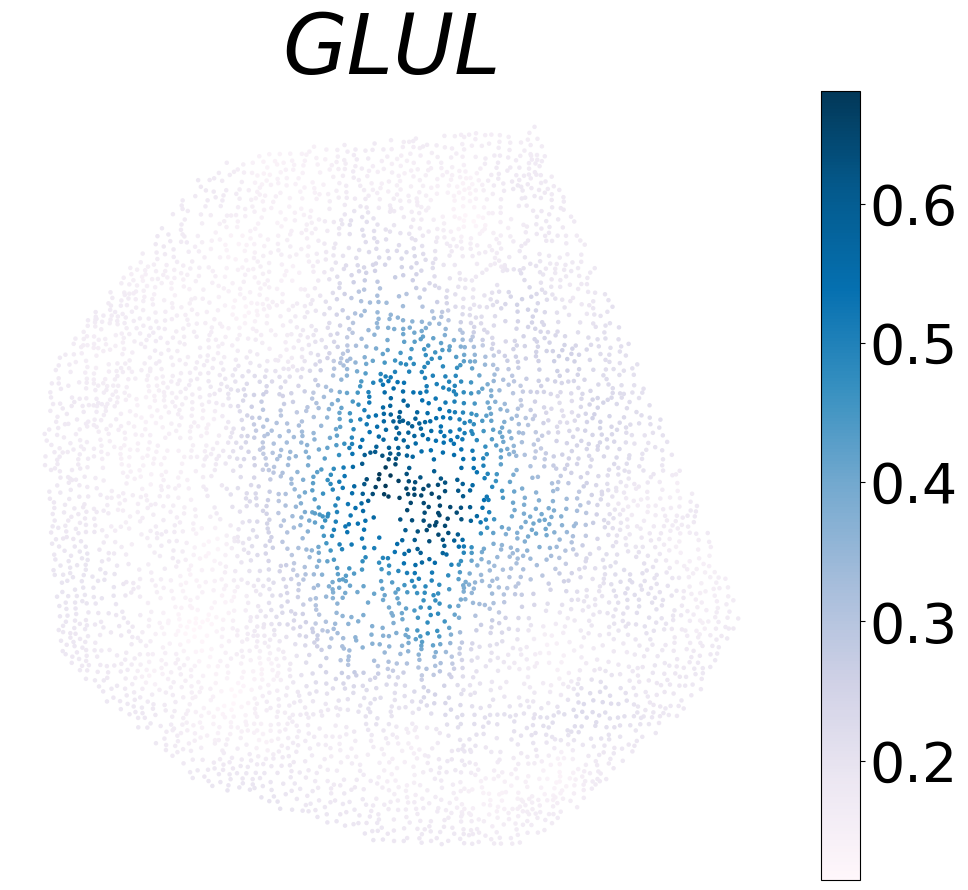

In [58]:
plt.figure(figsize=((10,9)))
scatter1 = plt.scatter(spatial1[:,0],spatial1[:,1],c=composite.X[:,np.where(data_slice1.var_names=='GLUL')],s=5,cmap='PuBu')
cbar = plt.colorbar(scatter1)
plt.axis("off")
plt.title('GLUL',fontsize=60, style='italic')
cbar.ax.tick_params(labelsize=40)

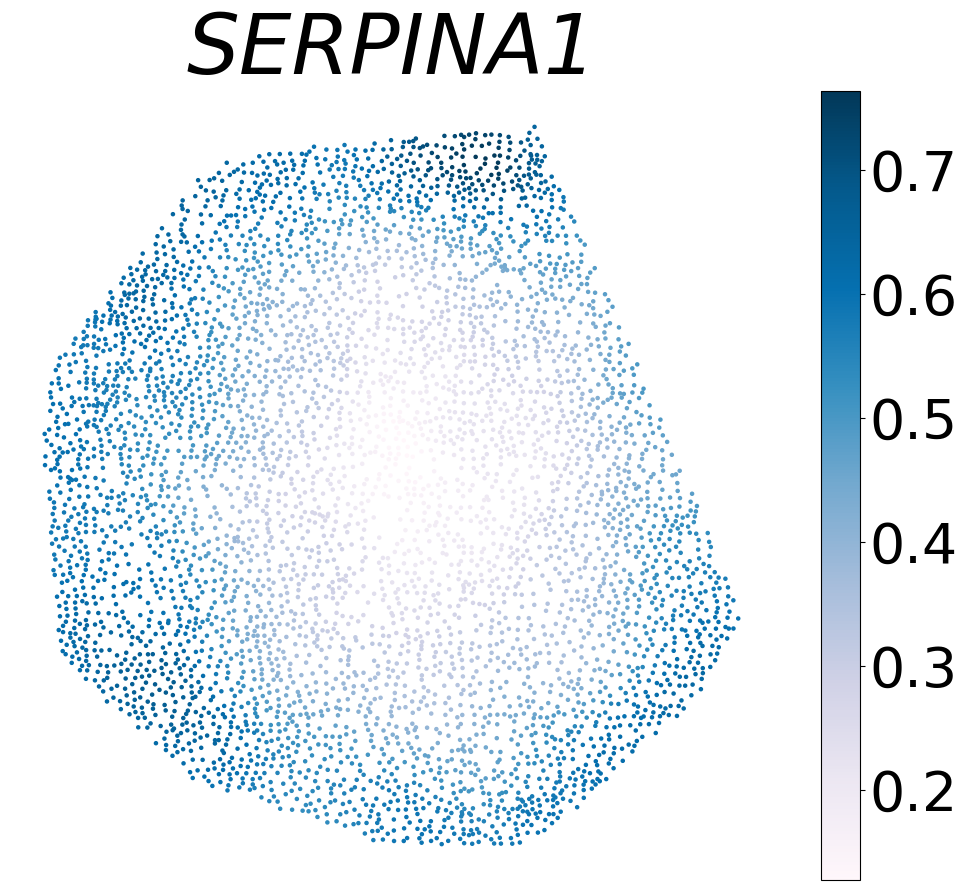

In [59]:
plt.figure(figsize=((10,9)))
scatter1 = plt.scatter(spatial1[:,0],spatial1[:,1],c=composite.X[:,np.where(data_slice1.var_names=='SERPINA1')],s=5,cmap='PuBu')
cbar = plt.colorbar(scatter1)
plt.axis("off")
plt.title('SERPINA1',fontsize=60, style='italic')
cbar.ax.tick_params(labelsize=40)

# Two new Visium liver (different health states)

In [195]:
fat2 = sc.read_h5ad(f'{path}/fat2.h5ad')
health1 = sc.read_h5ad(f'{path}/health1.h5ad')

In [196]:
embedding_fat2_ll=np.array(pd.read_csv(f'{path}/ll_fat2_ll.csv')).T
embedding_fat2_ll=embedding_fat2_ll[lm_library.uns['index_lm'],:]
embedding_fat2=np.array(pd.read_csv(f'{path}/ll_fat2_fat2.csv')).T

embedding_health1_ll=np.array(pd.read_csv(f'{path}/ll_health1_ll.csv')).T
embedding_health1_ll=embedding_health1_ll[lm_library.uns['index_lm'],:]
embedding_health1=np.array(pd.read_csv(f'{path}/ll_health1_health1.csv')).T

lm_library_spatial=lm_library.obsm['spatial']
lm_library_spatial=lm_library_spatial[lm_library.uns['index_lm'],:]

## Select landmarks and find hepatic lobular in Visium slice

In [197]:
lm_fat2_reference, lm_fat2 = alternative_landmark(lm_library_spatial, fat2.obsm['spatial'], embedding_fat2_ll, embedding_fat2, n = 100, replace1 = True)
lm_fat2_plot = lm_fat2.copy()

In [198]:
lm_health1_reference, lm_health1 = alternative_landmark(lm_library_spatial, health1.obsm['spatial'], embedding_health1_ll, embedding_health1, n = 600, replace1 = True)
lm_health1_plot = lm_health1.copy()

In [199]:
lm_fat2=lm_fat2[[77,94,50,46,85,53,97,60,3,5,95,23,21,0,62,48,47,52,33,58,25,20,86,69,34,24,40,87,34,38,98,67,6],:][[16,8,4,2,30,23],:]
lm_fat2_reference=lm_fat2_reference[[77,94,50,46,85,53,97,60,3,5,95,23,21,0,62,48,47,52,33,58,25,20,86,69,34,24,40,87,34,38,98,67,6],:][[23,16,2,8,4,30],:]
D=[]
for i in range(6):
    lm_fat2_test=np.vstack((lm_fat2[range(i,6),:],lm_fat2[range(0,i),:])) 
    lm_fat2_test=rigid_alignment(lm_fat2_reference, lm_fat2_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm_fat2_test-lm_fat2_reference,2),axis=1)))
    D.append(d)
lm_fat2=np.vstack((lm_fat2[range(np.argmin(D),6),:],lm_fat2[range(0,np.argmin(D)),:])) 

lm_health1=lm_health1[[343,545,532,527,340,510,139,158,161,540,587,309,66,549,557,227,547,46,164,576,74,210,292,574,303,4,186,591,118,530,272,529],:][[3,31,27,24,16,6],:]
lm_health1_reference=lm_health1_reference[[343,545,532,527,340,510,139,158,161,540,587,309,66,549,557,227,547,46,164,576,74,210,292,574,303,4,186,591,118,530,272,529],:][[6,24,16,27,3,31],:]
D=[]
for i in range(6):
    lm_health1_test=np.vstack((lm_health1[range(i,6),:],lm_health1[range(0,i),:])) 
    lm_health1_test=rigid_alignment(lm_health1_reference, lm_health1_test)
    d=np.sum(np.sqrt(np.sum(np.power(lm_health1_test-lm_health1_reference,2),axis=1)))
    D.append(d)
lm_health1=np.vstack((lm_health1[range(np.argmin(D),6),:],lm_health1[range(0,np.argmin(D)),:])) 

In [200]:
hull=ConvexHull(lm_fat2)
delaunay = Delaunay(lm_fat2[hull.vertices])
result_fat2 = delaunay.find_simplex(fat2.obsm['spatial'])>=0
line_fat2 = np.concatenate((lm_fat2[hull.vertices],lm_fat2[hull.vertices][0,:].reshape((1,2))),axis=0)

hull=ConvexHull(lm_health1)
delaunay = Delaunay(lm_health1[hull.vertices])
result_health1 = delaunay.find_simplex(health1.obsm['spatial'])>=0
line_health1 = np.concatenate((lm_health1[hull.vertices],lm_health1[hull.vertices][0,:].reshape((1,2))),axis=0)

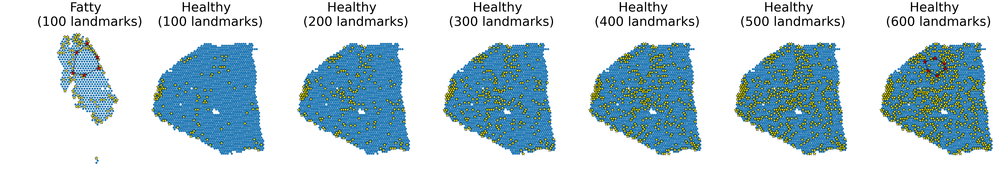

In [201]:
plt.figure(figsize=((70,10)))
plt.subplot(1,5,1)
plt.scatter(fat2.obsm['spatial'][:,0],fat2.obsm['spatial'][:,1],s=50)
plt.scatter(lm_fat2_plot[:,0],lm_fat2_plot[:,1],s=200,marker = "*",edgecolor = "black",c = 'yellow')
plt.scatter(lm_fat2[:,0],lm_fat2[:,1],s=400,marker = "*",edgecolor = "black",c='red')
plt.plot(line_fat2[:,0],line_fat2[:,1],c='black')
plt.axis('equal')
plt.axis("off")
plt.title('Fatty \n (100 landmarks)',fontsize=50)

for i in range(1,6):
    plt.subplot(1,7,i+1)
    plt.scatter(health1.obsm['spatial'][:,0],health1.obsm['spatial'][:,1],s=50)
    plt.scatter(lm_health1_plot[range(i*100),0],lm_health1_plot[range(i*100),1],s=200,marker = "*",edgecolor = "black", c = 'yellow')
    plt.axis('equal')
    plt.axis("off")
    plt.title(f'Healthy \n ({i}00 landmarks)',fontsize=50)

plt.subplot(1,7,7)
plt.scatter(health1.obsm['spatial'][:,0],health1.obsm['spatial'][:,1],s=50)
plt.scatter(lm_health1_plot[range(600),0],lm_health1_plot[range(600),1],s=200,marker = "*",edgecolor = "black",c = 'yellow')
plt.scatter(lm_health1[:,0],lm_health1[:,1],s=400,marker = "*",edgecolor = "black",c='red')
#plt.plot(x_sort_health1,y_sort_health1,c='black')
plt.plot(line_health1[:,0],line_health1[:,1],c='black')
plt.axis('equal')
plt.axis("off")
plt.title('Healthy \n (600 landmarks)',fontsize=50)


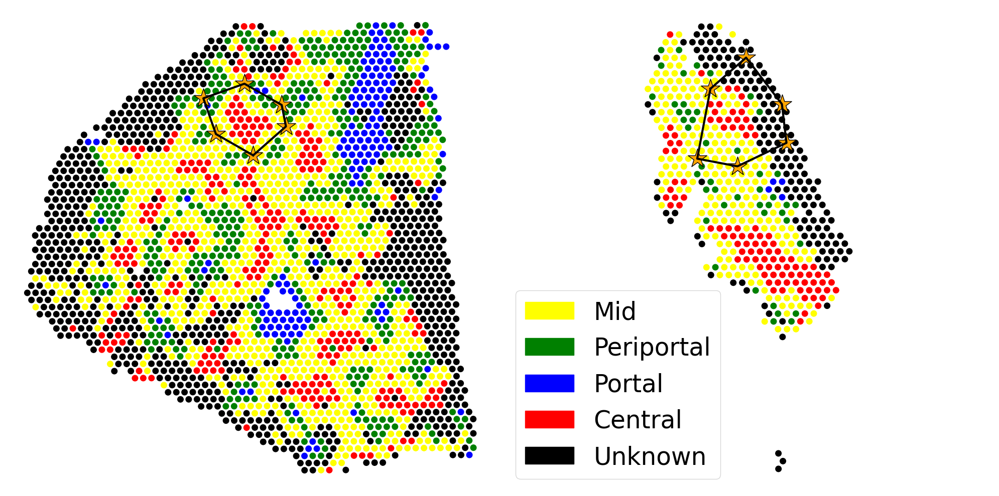

In [205]:
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
color_map = {'Mid': 'yellow', 'Central': 'red', 'Portal': 'blue','Periportal':'green','Unknown':'black'}
group=pd.DataFrame(health1.obsm['zonationGroup'])
group.columns=['zonationGroup']
c = group['zonationGroup'].map(color_map)
plt.scatter(health1.obsm['spatial'][:,0],health1.obsm['spatial'][:,1],c=c,s=70)
plt.scatter(lm_health1[:,0],lm_health1[:,1],s=800,marker = "*",edgecolor = "black",c='orange')
plt.plot(line_health1[:,0],line_health1[:,1],c='black', linewidth=3)

plt.axis('equal')
plt.axis("off")

plt.subplot(1,2,2)
color_map = {'Mid': 'yellow', 'Central': 'red', 'Portal': 'blue','Periportal':'green','Unknown':'black'}
group=pd.DataFrame(fat2.obsm['zonationGroup'])
group.columns=['zonationGroup']
c = group['zonationGroup'].map(color_map)
plt.scatter(fat2.obsm['spatial'][:,0],fat2.obsm['spatial'][:,1],c=c,s=70)
plt.scatter(lm_fat2[:,0],lm_fat2[:,1],s=800,marker = "*",edgecolor = "black",c='orange')
#plt.plot(x_sort_fat2,y_sort_fat2,c='black')
plt.plot(line_fat2[:,0],line_fat2[:,1],c='black', linewidth=3)

import matplotlib. patches as mpatches
patch1 = mpatches.Patch (color='yellow', label='Mid')
patch2 = mpatches.Patch (color='green', label='Periportal')   
patch3 = mpatches.Patch (color='blue', label='Portal')
patch4 = mpatches.Patch (color='red', label='Central') 
patch5 = mpatches.Patch (color='black', label='Unknown')
handles, labels = plt. gca (). get_legend_handles_labels ()
handles. extend ([patch1, patch2, patch3, patch4, patch5])
plt.legend (handles=handles,loc="lower left", fontsize=35)

plt.axis('equal')
plt.axis("off")


## Alignment

In [186]:
fat2=fat2[result_fat2,:]
health1=health1[result_health1,:]

lm_fat2, spatial_fat2 = rigid_alignment(lm_fat2_reference, lm_fat2, fat2.obsm['spatial'])
lm_fat2, spatial_fat2 = non_rigid_alignment(lm_fat2_reference, lm_fat2, spatial_fat2)

lm_health1, spatial_health1 = rigid_alignment(lm_health1_reference, lm_health1, health1.obsm['spatial'])
lm_health1, spatial_health1 = non_rigid_alignment(lm_health1_reference, lm_health1, spatial_health1)

## Transfer

In [187]:
composite_1 = composite.copy()
fat2_index=[]
health1_index=[]
composite_1_index=[]

for i in range(fat2.shape[1]):
    if(fat2.var_names[i] in health1.var_names):
        if(fat2.var_names[i] in composite_1.var_names):
            fat2_index.append(i)
            health1_index.append(np.where(health1.var_names==fat2.var_names[i])[0][0])
            composite_1_index.append(np.where(composite_1.var_names==fat2.var_names[i])[0][0])

fat2=fat2[:,fat2_index]
health1=health1[:,health1_index]
composite_1=composite_1[:,composite_1_index]

In [188]:
sc.pp.normalize_total(fat2, target_sum=1e4, inplace=True)
sc.tl.pca(fat2, svd_solver='arpack', n_comps=10)

sc.pp.normalize_total(health1, target_sum=1e4, inplace=True)
sc.tl.pca(health1, svd_solver='arpack', n_comps=10)

E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\scanpy\preprocessing\_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)
E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\scanpy\preprocessing\_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [189]:
x1 = torch.tensor(composite.obsm['spatial']).float()
x2 = torch.tensor(spatial_health1).float()
y2 = torch.tensor(health1.obsm['X_pca'].copy()).float()
pre_health1_pca = Exact_GP(x1, x2, y2, num_epochs = 200)
pre_health1_pca = pre_health1_pca.numpy()
pre_health1_pca_all = np.dot(pre_health1_pca,health1.varm['PCs'].T)

x1 = torch.tensor(composite.obsm['spatial']).float()
x2 = torch.tensor(spatial_fat2.copy()).float()
y2 = torch.tensor(fat2.obsm['X_pca'].copy()).float()
pre_fat2_pca = Exact_GP(x1, x2, y2, num_epochs = 200)
pre_fat2_pca = pre_fat2_pca.numpy()
pre_fat2_pca_all = np.dot(pre_fat2_pca,fat2.varm['PCs'].T)

In [190]:
pre_health1_pca_all_to01=pre_health1_pca_all.copy()
for j in range(pre_health1_pca_all_to01.shape[1]):
    if(np.max(pre_health1_pca_all[:,j])!= np.min(pre_health1_pca_all[:,j])):
        pre_health1_pca_all_to01[:,j]=(pre_health1_pca_all[:,j]-np.min(pre_health1_pca_all[:,j]))/(np.max(pre_health1_pca_all[:,j])-np.min(pre_health1_pca_all[:,j]))
    else:
        pre_health1_pca_all_to01[:,j]=np.repeat(0.5, pre_health1_pca_all_to01.shape[0])
pre_fat2_pca_all_to01=pre_fat2_pca_all.copy()
for j in range(pre_fat2_pca_all_to01.shape[1]):
    if (np.max(pre_health1_pca_all[:,j])!= np.min(pre_health1_pca_all[:,j])):
        pre_fat2_pca_all_to01[:,j]=(pre_fat2_pca_all[:,j]-np.min(pre_fat2_pca_all[:,j]))/(np.max(pre_fat2_pca_all[:,j])-np.min(pre_fat2_pca_all[:,j]))
    else:
        pre_fat2_pca_all_to01[:,j]=np.repeat(0.5, pre_health1_pca_all_to01.shape[0])

## Find suspicious genes

In [191]:
fat2_cor=[]
health1_cor=[]
for i in range(fat2.shape[1]):
    health1_cor.append(np.corrcoef(composite_1.X[:,i],pre_health1_pca_all_to01[:,i])[0,1])
    fat2_cor.append(np.corrcoef(composite_1.X[:,i],pre_fat2_pca_all_to01[:,i])[0,1])

E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\numpy\lib\function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
E:\ProgramFiles\anaconda3\envs\py39\lib\site-packages\numpy\lib\function_base.py:2898: RuntimeWarning: invalid value encountered in divide
  c /= stddev[None, :]


In [192]:
for i in range(len(health1_cor)):
    if((health1_cor[i]>0.6) & (fat2_cor[i]<0.4)):
        print(health1.var_names[i])
        print(health1_cor[i])
        print(fat2_cor[i])

GLUL
0.7209134755332596
0.3571851304928761
SPINK1
0.6346391112162566
0.20656345900550932
ADIRF
0.7506648706989069
0.0036100258389334806
